In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import pylab as pl
import numpy as np
import seaborn as sns
from sklearn.metrics import r2_score
%config InlineBackend.figure_format = 'svg'

In [2]:
path = r"..\\"
df = pd.read_csv(path+'QUOTAS.csv')
df.head()

,name,ra,dec,z,log_bh,log_edd_ratio,log_edd_ratio_err,log_lbol,log_lbol_err,log_l1350,...,log_bh_mgii_md04,log_bh_mgii_md04_err,log_bh_mgii_s10,log_bh_mgii_s10_err,log_bh_mgii_s11,log_bh_mgii_s11_err,log_bh_mgii_vo09,log_bh_mgii_vo09_err,log_bh_mgii_vp06,refcode
0,SDSS J000024.83+245703.3,0.10346,24.95094,3.2137,8.523043,-0.005008,NaN,46.618406,0.016568,46.037481,...,0.0,-1.0,0.0,-1.0,NaN,NaN,0.0,-1.0,NaN,2011ApJS..194...45S
1,SDSS J000046.41+011420.8,0.19341,1.23912,3.7589,9.359629,-0.779397,NaN,46.680603,0.017066,46.099678,...,0.0,-1.0,0.0,-1.0,NaN,NaN,0.0,-1.0,NaN,2011ApJS..194...45S
2,SDSS J000051.56+001202.5,0.21486,0.20071,3.9713,0.000000,-999.000000,NaN,47.005828,0.043150,46.424903,...,0.0,-1.0,0.0,-1.0,NaN,NaN,0.0,-1.0,NaN,2011ApJS..194...45S
3,SDSS J000135.51-004206.7,0.39798,-0.70189,3.5816,9.530387,-0.649432,NaN,46.981325,0.010017,46.400400,...,0.0,-1.0,0.0,-1.0,NaN,NaN,0.0,-1.0,NaN,2011ApJS..194...45S
4,SDSS J000216.66-053007.6,0.56945,-5.50212,3.1592,9.523970,-0.381170,NaN,47.243170,0.005010,46.662245,...,0.0,-1.0,0.0,-1.0,NaN,NaN,0.0,-1.0,NaN,2011ApJS..194...45S


In [3]:
df.describe()

,ra,dec,z,log_bh,log_edd_ratio,log_edd_ratio_err,log_lbol,log_lbol_err,log_l1350,log_l1350_err,...,log_bh_mgii_err,log_bh_mgii_md04,log_bh_mgii_md04_err,log_bh_mgii_s10,log_bh_mgii_s10_err,log_bh_mgii_s11,log_bh_mgii_s11_err,log_bh_mgii_vo09,log_bh_mgii_vo09_err,log_bh_mgii_vp06
count,37648.000000,37648.000000,37648.000000,34896.000000,37488.000000,125.000000,37601.000000,37360.000000,8162.000000,8162.000000,...,50.000000,7995.000000,7955.0,7955.0,7955.0,93.000000,93.000000,7955.0,7955.0,3.000000
mean,179.154813,23.241975,3.416250,8.933419,-14.766663,0.108885,45.149593,-0.013737,45.878229,0.018277,...,0.320274,0.044748,-1.0,0.0,-1.0,2.796702,-0.622526,0.0,-1.0,9.206295
std,80.729325,17.987131,0.425583,1.193785,115.504200,0.296570,14.387546,1.011261,4.660408,0.284472,...,1.227573,0.631599,0.0,0.0,0.0,4.290855,0.618810,0.0,0.0,0.218517
min,0.005910,-64.919610,3.000300,0.000000,-999.000000,-1.000000,-99.999000,-9.999000,0.000000,-1.000000,...,0.010000,0.000000,-1.0,0.0,-1.0,0.000000,-1.000000,0.0,-1.0,8.954243
25%,141.390150,8.382760,3.123000,8.691000,-0.847000,0.027774,46.359000,0.072000,46.136257,0.014684,...,0.052500,0.000000,-1.0,0.0,-1.0,0.000000,-1.000000,0.0,-1.0,9.138231
50%,181.348815,21.927655,3.270000,9.079000,-0.582000,0.059918,46.631000,0.092000,46.318163,0.022538,...,0.090000,0.000000,-1.0,0.0,-1.0,0.000000,-1.000000,0.0,-1.0,9.322219
75%,221.661908,36.080852,3.616000,9.415000,-0.287000,0.140000,46.892721,0.106000,46.530774,0.032298,...,0.204215,0.000000,-1.0,0.0,-1.0,8.874807,0.058078,0.0,-1.0,9.332321
max,359.994270,83.620140,7.100000,11.121000,1.223000,2.121076,48.291068,45.477121,47.710143,22.647862,...,8.763428,9.820000,-1.0,0.0,-1.0,9.943328,2.121013,0.0,-1.0,9.342423


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37648 entries, 0 to 37647
Columns: 135 entries, name to refcode
dtypes: float64(133), object(2)
memory usage: 38.8+ MB


In [5]:
df.shape

(37648, 135)

In [6]:
#the duplicated data entries
df.duplicated().sum()

5

In [7]:
df = df.drop_duplicates()
df = df.select_dtypes(include=['int64', 'float64'])
df.describe().T

,count,mean,std,min,25%,50%,75%,max
ra,37643.0,179.162605,80.725417,0.005910,141.396215,181.347860,221.666655,359.994270
dec,37643.0,23.243864,17.984780,-64.919610,8.382890,21.926860,36.081340,83.620140
z,37643.0,3.415994,0.424887,3.000300,3.123000,3.270000,3.616000,7.100000
log_bh,34896.0,8.933419,1.193785,0.000000,8.691000,9.079000,9.415000,11.121000
log_edd_ratio,37488.0,-14.766663,115.504200,-999.000000,-0.847000,-0.582000,-0.287000,1.223000
...,...,...,...,...,...,...,...,...
log_bh_mgii_s11,93.0,2.796702,4.290855,0.000000,0.000000,0.000000,8.874807,9.943328
log_bh_mgii_s11_err,93.0,-0.622526,0.618810,-1.000000,-1.000000,-1.000000,0.058078,2.121013
log_bh_mgii_vo09,7955.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
log_bh_mgii_vo09_err,7955.0,-1.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000


In [8]:
df.isnull().sum()

ra                          0
dec                         0
z                           0
log_bh                   2747
log_edd_ratio             155
                        ...  
log_bh_mgii_s11         37550
log_bh_mgii_s11_err     37550
log_bh_mgii_vo09        29688
log_bh_mgii_vo09_err    29688
log_bh_mgii_vp06        37640
Length: 133, dtype: int64

In [9]:
cdf = df[['z','log_bh','log_edd_ratio','log_lbol']]
cdf.head(10)

,z,log_bh,log_edd_ratio,log_lbol
0,3.2137,8.523043,-0.005008,46.618406
1,3.7589,9.359629,-0.779397,46.680603
2,3.9713,0.000000,-999.000000,47.005828
3,3.5816,9.530387,-0.649432,46.981325
4,3.1592,9.523970,-0.381170,47.243170
5,3.0699,9.453152,-0.280249,47.273274
6,3.9383,9.115628,-0.457994,46.758005
7,3.6829,8.728531,-0.292702,46.536200
8,3.6983,9.483382,-0.636893,46.946859
9,3.6458,9.042125,-0.046328,47.096167


In [10]:
#Data such as -999 or 0.00 are non-physical, thus have to be removed:
cdf = cdf[(cdf > -9) & (cdf != 0) & (cdf < 90)]  
cdf

,z,log_bh,log_edd_ratio,log_lbol
0,3.2137,8.523043,-0.005008,46.618406
1,3.7589,9.359629,-0.779397,46.680603
2,3.9713,NaN,NaN,47.005828
3,3.5816,9.530387,-0.649432,46.981325
4,3.1592,9.523970,-0.381170,47.243170
...,...,...,...,...
37643,7.1000,9.208819,-0.318759,47.174205
37644,6.9000,9.322219,-0.744727,46.684935
37645,6.7000,9.031291,-0.619789,46.741191
37646,6.6000,9.028452,-0.167491,46.931915


In [11]:
cdf.isnull().sum()

z                   0
log_bh           3258
log_edd_ratio    3399
log_lbol          484
dtype: int64

In [12]:
cdf = cdf.dropna()
cdf

,z,log_bh,log_edd_ratio,log_lbol
0,3.2137,8.523043,-0.005008,46.618406
1,3.7589,9.359629,-0.779397,46.680603
3,3.5816,9.530387,-0.649432,46.981325
4,3.1592,9.523970,-0.381170,47.243170
5,3.0699,9.453152,-0.280249,47.273274
...,...,...,...,...
37643,7.1000,9.208819,-0.318759,47.174205
37644,6.9000,9.322219,-0.744727,46.684935
37645,6.7000,9.031291,-0.619789,46.741191
37646,6.6000,9.028452,-0.167491,46.931915


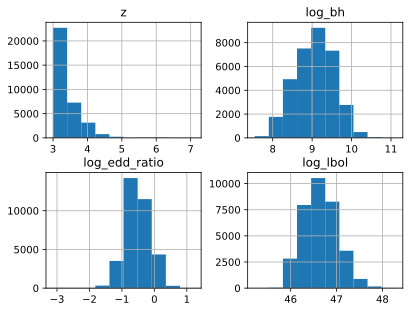

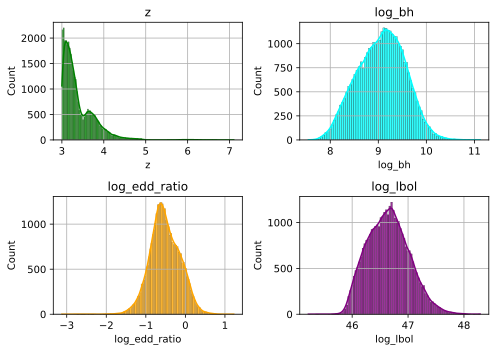

In [13]:
viz = cdf
viz.hist()
plt.show()

#Pretty-fying the histogram:
colors = ['green', 'cyan', 'orange', 'purple']
fig, axes = plt.subplots(2, 2, figsize=(7, 5))
axes = axes.flatten()
for i, variable in enumerate(cdf.columns):
    color = colors[i]
    sns.histplot(cdf[variable], ax=axes[i], kde=True, alpha=0.8, color=color)
    axes[i].set_title(variable)
    axes[i].grid(True)
fig.tight_layout()
plt.show()

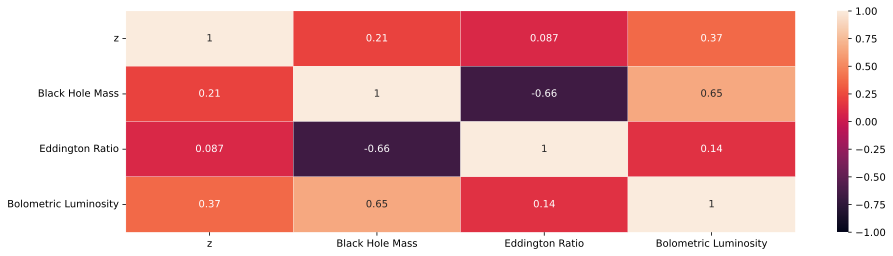

In [14]:
plt.figure(figsize=(15, 4))
corr_dict = {'z':'z','log_bh':'Black Hole Mass', 'log_edd_ratio': 'Eddington Ratio', 'log_lbol': 'Bolometric Luminosity'}
corr = cdf.corr(numeric_only=True)
dataplot = sns.heatmap(corr, annot=True, linewidths=.2, 
                        xticklabels=[corr_dict[col] for col in corr.columns],
                        yticklabels=[corr_dict[col] for col in corr.columns],
                        vmin=-1, vmax=1)

In [15]:
plt.scatter(cdf.z, cdf.log_bh,  color='blue')
plt.xlabel("$z$")
plt.ylabel("$M_{BH} [M_{\odot}]$")
plt.grid(True)
plt.show()

<>:3: SyntaxWarning: invalid escape sequence '\o'
<>:3: SyntaxWarning: invalid escape sequence '\o'
C:\Users\Asus\AppData\Local\Temp\ipykernel_6900\3574589505.py:3: SyntaxWarning: invalid escape sequence '\o'
  plt.ylabel("$M_{BH} [M_{\odot}]$")


In [16]:
plt.scatter(cdf.log_bh, cdf.log_lbol,  color='r', alpha=0.5)
plt.xlabel("Log $L_{bol}$")
plt.ylabel("Log $M_{BH} [M_{\odot}]$")
plt.grid(True)
plt.show()

<>:3: SyntaxWarning: invalid escape sequence '\o'
<>:3: SyntaxWarning: invalid escape sequence '\o'
C:\Users\Asus\AppData\Local\Temp\ipykernel_6900\1267782684.py:3: SyntaxWarning: invalid escape sequence '\o'
  plt.ylabel("Log $M_{BH} [M_{\odot}]$")


In [17]:
msk = np.random.rand(len(cdf)) < 0.8 #random data in the numbers of df's length which are lower than 80% or 0.8
#in this list, 80% of the data are True and 20% are False.
train = cdf[msk]
test = cdf[~msk]
print(msk), print(~msk)
print(train), print(test)

[ True  True  True ...  True  True  True]
[False False False ... False False False]
            z    log_bh  log_edd_ratio   log_lbol
0      3.2137  8.523043      -0.005008  46.618406
1      3.7589  9.359629      -0.779397  46.680603
3      3.5816  9.530387      -0.649432  46.981325
4      3.1592  9.523970      -0.381170  47.243170
5      3.0699  9.453152      -0.280249  47.273274
...       ...       ...            ...        ...
37643  7.1000  9.208819      -0.318759  47.174205
37644  6.9000  9.322219      -0.744727  46.684935
37645  6.7000  9.031291      -0.619789  46.741191
37646  6.6000  9.028452      -0.167491  46.931915
37647  7.0700  8.518514      -0.468521  46.146128

[27410 rows x 4 columns]
            z    log_bh  log_edd_ratio   log_lbol
9      3.6458  9.042125      -0.046328  47.096167
19     3.1518  9.557189      -0.293262  47.364297
20     3.1060  9.467763      -0.407809  47.160324
27     3.1866  9.516789      -0.689577  46.927582
31     3.5755  9.292827      -0.133099  

(None, None)

# Linear Regression

In [19]:
fig, axes = plt.subplots(2, 1, figsize=(8, 6))
axes = axes.flatten()
x_col = ["z", "log_bh"]
y_col = ["log_bh", "log_lbol"]
colors_train = ["cyan", "green"]
colors_test = ["purple", "orange"]
for i in range(0,2):
    color_tr = colors_train[i]
    color_ts = colors_test[i]
    axes[i].scatter(train[x_col[i]], train[y_col[i]],  color=color_tr, label='Train')
    axes[i].scatter(test[x_col[i]], test[y_col[i]],  color=color_ts, label='Test')
    axes[i].grid(True)
    axes[i].set_xlabel(x_col[i])
    axes[i].set_ylabel(y_col[i])
    axes[i].legend()
fig.tight_layout()
plt.show()

In [20]:
from sklearn import linear_model
z = np.asanyarray(train[['z']]);lbol = np.asanyarray(train[['log_lbol']]);bh = np.asanyarray(train[['log_bh']])
regr = linear_model.LinearRegression()
regr.fit (z, bh)
print ('Coefficients_z_vs_bh: ', regr.coef_)
print ('Intercept_z_vs_bh: ',regr.intercept_)

regr_bh = linear_model.LinearRegression()
regr_bh.fit (bh, lbol)
print ('Coefficients_bh_vs_lbol: ', regr_bh.coef_)
print ('Intercept_bh_vs_lbol: ',regr_bh.intercept_)

Coefficients_z_vs_bh:  [[0.27368116]]
Intercept_z_vs_bh:  [8.13603563]
Coefficients_bh_vs_lbol:  [[0.49065839]]
Intercept_bh_vs_lbol:  [42.19892114]


In [21]:
train = train.reset_index(drop=True)

In [22]:
train_z = train['z'];train_bh = train['log_bh'];train_lbol = train['log_lbol']

orderz = np.argsort(train_z);orderbh = np.argsort(train_bh);orderlbol = np.argsort(train_lbol)

train_z_sorted = train_z[orderz];train_bh_sorted = train_bh[orderbh]
train_lbol_sorted = train_lbol[orderlbol];train_bhz = train_bh[orderz]

In [23]:
fig, axes = plt.subplots(2, 1, figsize=(8, 6))
axes = axes.flatten()
x_col = ["z", "log_bh"];y_col = ["log_bh", "log_lbol"];train_sort_x = [train_z_sorted,train_bh_sorted];
colors_train = ["cyan", "green"];colors_test = ["purple", "orange"];reg=[regr,regr_bh];markers=['o','+','.']
for i in range(0,2):
    color_tr = colors_train[i];color_ts = colors_test[i]
    axes[i].scatter(train[x_col[i]], train[y_col[i]],  color=color_tr, label='Train',marker=markers[i])
    axes[i].scatter(test[x_col[i]], test[y_col[i]],  color=color_ts, label='Test',marker=markers[i+1])
    axes[i].plot(train_sort_x[i],  reg[i].coef_[0][0]*train_sort_x[i] +reg[i].intercept_[0], '-r',
                 label='Regression line: {}x + {}'.format(reg[i].coef_[0][0].round(2),reg[i].intercept_[0].round(2)))
    axes[i].grid(True)
    axes[i].set_xlabel(x_col[i])
    axes[i].set_ylabel(y_col[i])
    axes[i].set_title('Linear Regression for '+ x_col[i] +' Vs. '+ y_col[i])
    axes[i].legend()
fig.tight_layout()
plt.show()

In [24]:
test_z = np.asanyarray(test[['z']])
test_bh = np.asanyarray(test[['log_bh']])
test_lbol = np.asanyarray(test[['log_lbol']])

test_y_z = regr.predict(test_z)
test_y_bh = regr_bh.predict(test_bh)

print("MAE: z/bh: %.2f Vs. bh/lbol: %.2f" % (np.mean(np.absolute(test_y_z - test_bh)),np.mean(np.absolute(test_y_bh - test_lbol))))
print("MSE: z/bh: %.2f Vs. bh/lbol: %.2f" % (np.mean((test_y_z - test_bh)**2),np.mean((test_y_bh - test_lbol)**2)))
print("R2-score: z/bh: %.2f Vs. bh/lbol: %.2f" % (r2_score(test_bh,test_y_z),r2_score(test_lbol,test_y_bh))) 
#The result is expected from the initial heatmap

MAE: z/bh: 0.39 Vs. bh/lbol: 0.22
MSE: z/bh: 0.23 Vs. bh/lbol: 0.08
R2-score: z/bh: 0.05 Vs. bh/lbol: 0.42


----

# Multiple Linear Regression

In [27]:
regr_mult = linear_model.LinearRegression()
x = np.asanyarray(train[['z','log_bh']])
y = np.asanyarray(train[['log_lbol']])
regr_mult.fit(x, y)
# The coefficients
print ('Coefficients: ', regr_mult.coef_)

Coefficients:  [[0.23766712 0.45071611]]


In [61]:
def reg_zbh(x_z,y_bh):
    return regr_mult.coef_[0][0]*x_z + regr_mult.coef_[0][1]*y_bh + regr_mult.intercept_[0]
train['lbol_pred'] = [reg_zbh(x[0], x[1]) for x in x]
sort_lbol_pred = np.sort(train['lbol_pred'].values)
sort_lbol_pred

array([45.87374294, 45.88699455, 45.91303094, ..., 47.7265032 ,
       47.74638148, 47.81812989])

In [65]:
plt.scatter(train['z'], train['log_lbol'],  color="green", label='Train',marker='o')
plt.scatter(test['z'], test['log_lbol'],  color="orange", label='Test',marker='.')
plt.plot(train_z_sorted,  sort_lbol_pred, c='r', label='Regression line: {}$z$ + {}$M$ + {}'
                 .format(regr_mult.coef_[0][0].round(2),
                 regr_mult.coef_[0][1].round(2),
                 regr_mult.intercept_[0].round(2)))
plt.plot(np.linspace(min(train_z),max(train_z),100),
         reg_zbh(np.linspace(min(train_z),max(train_z),100),
                 np.linspace(min(train_bh),max(train_bh),100)),
         'b.-',alpha=0.5, label='Regression line: Function')
plt.grid(True)
plt.xlabel(x_col[0])
plt.ylabel(y_col[1])
plt.title('Multiple Linear Regression for '+ x_col[0] +' Vs. '+ y_col[1])
plt.legend()
fig.tight_layout()
plt.show()

In [87]:
y_hat = regr_mult.predict(test[['z','log_bh']])
x = np.asanyarray(test[['z','log_bh']])
y = np.asanyarray(test[['log_lbol']])
print("Residual sum of squares: %.2f"
      % np.mean((y_hat - y) ** 2))
# Explained variance score: 1 is perfect prediction
print('Variance score: %.2f' % regr_mult.score(x, y))
print('R2-score: z/bh/lbol %.2f Vs. before bh/lbol %.2f' % ( r2_score(y,y_hat),r2_score(test_lbol,test_y_bh)))

Residual sum of squares: 0.07
Variance score: 0.48
R2-score: z/bh/lbol 0.48 Vs. before bh/lbol 0.42


C:\Users\Asus\anaconda3\Lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


------

# Non-Linear Regression

## Polynomial Regression

In [138]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn import linear_model
#bh = np.asarray[train[['log_bh']]]
poly = PolynomialFeatures(degree=2)
train_bh_poly = poly.fit_transform(bh)
train_bh_poly

array([[ 1.        ,  8.52304301, 72.64226212],
       [ 1.        ,  9.35962943, 87.60266307],
       [ 1.        ,  9.53038674, 90.82827136],
       ...,
       [ 1.        ,  9.03129099, 81.56421698],
       [ 1.        ,  9.02845243, 81.51295321],
       [ 1.        ,  8.51851394, 72.56507975]])

In [140]:
clf = linear_model.LinearRegression()
train_bh_poly_ = clf.fit(train_bh_poly, lbol)
# The coefficients
print ('Coefficients: ', clf.coef_)
print ('Intercept: ',clf.intercept_)

Coefficients:  [[ 0.         -0.63967243  0.06242405]]
Intercept:  [47.30071596]


In [142]:
plt.scatter(train.log_bh, train.log_lbol,  color='green',label='Train')
plt.scatter(test.log_bh, test.log_lbol,  color='orange',marker='.',label='Test')
XX = np.arange(min(train.log_bh)-5, max(train.log_bh)+5, 0.1)
yy = clf.intercept_[0]+ clf.coef_[0][1]*XX+ clf.coef_[0][2]*np.power(XX, 2)
plt.plot(XX, yy, '-r' ,label='Regression Line: %.2f $M^2$ + %.2f $M$ + %.2f' % ( clf.coef_[0][2],
                                                                                 clf.coef_[0][1],
                                                                                 clf.intercept_[0]))
plt.title('Polynomial Regression for $M_{BH}$ Vs. $L_{bol}$')
plt.xlabel("Log $M_{BH} [M_{\odot}]$")
plt.ylabel("Log $L_{bol}$")
plt.legend()
plt.grid(True)
plt.show()

<>:9: SyntaxWarning: invalid escape sequence '\o'
<>:9: SyntaxWarning: invalid escape sequence '\o'
C:\Users\Asus\AppData\Local\Temp\ipykernel_6900\3298685946.py:9: SyntaxWarning: invalid escape sequence '\o'
  plt.xlabel("Log $M_{BH} [M_{\odot}]$")


In [118]:
test_bh_poly = poly.fit_transform(test_bh)
test_bh_poly_ = clf.predict(test_bh_poly)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_bh_poly_ - test_lbol)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_bh_poly_ - test_lbol) ** 2))
print("R2-score: %.2f" % r2_score(test_lbol,test_bh_poly_ ))

Mean absolute error: 0.22
Residual sum of squares (MSE): 0.08
R2-score: 0.42


In [136]:
poly3 = PolynomialFeatures(degree=3)
train_bh_poly3 = poly3.fit_transform(bh)
clf3 = linear_model.LinearRegression()
train_bh3_ = clf3.fit(train_bh_poly3, lbol)

# The coefficients
print ('Coefficients: ', clf3.coef_)
print ('Intercept: ',clf3.intercept_)
plt.scatter(train.log_bh, train.log_lbol,  color='green',label='Train')
plt.scatter(test.log_bh, test.log_lbol,  color='orange',marker='.',label='Test')
XX = np.arange(min(train.log_bh)-5, max(train.log_bh)+5, 0.1)
yy = clf3.intercept_[0]+ clf3.coef_[0][1]*XX + clf3.coef_[0][2]*np.power(XX, 2) + clf3.coef_[0][3]*np.power(XX, 3)
plt.plot(XX, yy, '-r',label='Regression Line: %f $M^3$ + %.2f $M^2$ + %.2f $M$ + %.2f' % ( clf3.coef_[0][3],clf3.coef_[0][2],
                                                                                          clf3.coef_[0][1], clf3.intercept_[0]) )
plt.title('Third degree Polynomial Regression for $M_{BH}$ Vs. $L_{bol}$')
plt.xlabel("Log $M_{BH} [M_{\odot}]$")
plt.ylabel("Log $L_{bol}$")
plt.legend()
plt.grid(True)
plt.show()
test_bh_poly3 = poly3.fit_transform(test_bh)
test_bh3_ = clf3.predict(test_bh_poly3)
print("Mean absolute error: %.2f" % np.mean(np.absolute(test_bh3_ - test_lbol)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_bh3_ - test_lbol) ** 2))
print("R2-score: %.2f" % r2_score(test_lbol,test_bh3_ ) )


<>:16: SyntaxWarning: invalid escape sequence '\o'
<>:16: SyntaxWarning: invalid escape sequence '\o'
C:\Users\Asus\AppData\Local\Temp\ipykernel_6900\1271414273.py:16: SyntaxWarning: invalid escape sequence '\o'
  plt.xlabel("Log $M_{BH} [M_{\odot}]$")


Coefficients:  [[ 0.         -1.13189135  0.11665391 -0.00198648]]
Intercept:  [48.78606805]


Mean absolute error: 0.22
Residual sum of squares (MSE): 0.08
R2-score: 0.42


------